# Setup

In [3]:
# prompt: mount google drive to current working directory
try:
    import google.colab
    IN_COLAB = True
except:
    IN_COLAB = False

# Plotly needs a different renderer for VSCode/Notebooks vs Colab argh
import plotly.io as pio
if IN_COLAB:
    pio.renderers.default = "colab"
else:
    pio.renderers.default = "vscode"
print(f"Using renderer: {pio.renderers.default}")

Using renderer: colab


In [4]:
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [5]:
from huggingface_hub import hf_hub_download, notebook_login, login

with open("/content/gdrive/MyDrive/hf_token", "r") as f:
    token = f.read().strip()
    login(token, add_to_git_credential=True)

Token is valid (permission: read).
Your token has been saved in your configured git credential helpers (store).
Your token has been saved to /root/.cache/huggingface/token
Login successful


In [6]:
import torch
import os

In [7]:
if IN_COLAB:
    device = "cuda" if torch.cuda.is_available() else "cpu"
else:
    device = "mps" if torch.backends.mps.is_available() else "cpu"

# Load model

In [8]:
from transformers import LlavaNextProcessor, LlavaNextForConditionalGeneration
import torch
from PIL import Image
import requests

processor = LlavaNextProcessor.from_pretrained("llava-hf/llava-v1.6-mistral-7b-hf",
                                               cache_dir="./checkpoints")

model = LlavaNextForConditionalGeneration.from_pretrained("llava-hf/llava-v1.6-mistral-7b-hf",
                                                          cache_dir="./checkpoints",
                                                          torch_dtype=torch.float16,
                                                          low_cpu_mem_usage=True)
model.to(device)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning:


The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.



preprocessor_config.json:   0%|          | 0.00/772 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/1.98k [00:00<?, ?B/s]

tokenizer.model:   0%|          | 0.00/493k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.80M [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/41.0 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/552 [00:00<?, ?B/s]

chat_template.json:   0%|          | 0.00/695 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.28k [00:00<?, ?B/s]

model.safetensors.index.json:   0%|          | 0.00/70.2k [00:00<?, ?B/s]

model-00001-of-00004.safetensors:   0%|          | 0.00/4.92G [00:00<?, ?B/s]

model-00002-of-00004.safetensors:   0%|          | 0.00/4.92G [00:00<?, ?B/s]

model-00003-of-00004.safetensors:   0%|          | 0.00/4.92G [00:00<?, ?B/s]

model-00004-of-00004.safetensors:   0%|          | 0.00/380M [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/4 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

LlavaNextForConditionalGeneration(
  (vision_tower): CLIPVisionModel(
    (vision_model): CLIPVisionTransformer(
      (embeddings): CLIPVisionEmbeddings(
        (patch_embedding): Conv2d(3, 1024, kernel_size=(14, 14), stride=(14, 14), bias=False)
        (position_embedding): Embedding(577, 1024)
      )
      (pre_layrnorm): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
      (encoder): CLIPEncoder(
        (layers): ModuleList(
          (0-23): 24 x CLIPEncoderLayer(
            (self_attn): CLIPSdpaAttention(
              (k_proj): Linear(in_features=1024, out_features=1024, bias=True)
              (v_proj): Linear(in_features=1024, out_features=1024, bias=True)
              (q_proj): Linear(in_features=1024, out_features=1024, bias=True)
              (out_proj): Linear(in_features=1024, out_features=1024, bias=True)
            )
            (layer_norm1): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
            (mlp): CLIPMLP(
              (activation_fn

# Loading images (Google Drive for now)

In [64]:
img_dir = '/content/gdrive/MyDrive/vlm_mats_images/'
img_files = !ls {img_dir}

def path_helper(img_path, img_dir='/content/gdrive/MyDrive/vlm_mats_images/'):
  if img_path[-1] in(["'", '"']):
    img_path = img_path[:-1]
  return img_dir + img_path[1:]

# Generated images and schema of prompting

10 images were generated using either Imagen3 (Gemini, Google) or Dalle (chatGPT, OpenAI). They are on [Google Drive here](https://drive.google.com/drive/u/0/folders/1GjJctxLlsVI1QZTgirXbgOYONCZhiOd1).

Format is: common object with unexpected attribute, such as:


*   Blue strawberry (unexpected: color)
*   Square basketball (unexpected: shape)
*   Round chessboard (unexpected: shape)
*   Melting chair (unexpected: texture)
*   Winged dog (unexpected: limbs)
*   Cat with carrot ears (unexpected: limbs)

We then ask 5 types of prompts


1.   General description
2.   Target expected attribute --> Yes / No
3.   Target unexpected attribute --> Yes / No
4.   Target expected attribute in 2 hops --> Yes / No
5.   Target unexpected attribute in 2 hops --> Yes / No









In [65]:
def generate_text_output(img, prompt, max_new_tokens=100):
  inputs = processor(images=img, text=prompt, return_tensors="pt").to(device)
  # autoregressively complete prompt
  output = model.generate(**inputs, max_new_tokens=max_new_tokens)
  return processor.decode(output[0], skip_special_tokens=True)

In [66]:
def image_five_prompts(img_path, subject, expected_attribute, unexpected_attribute):
  row = {}
  row['img_path'] = img_path

  # General description
  prompt = "[INST] <image>\nWhat is shown in this image? [/INST]"
  row['general'] = generate_text_output(img, prompt)

  # Target attribute (expected) -> Yes / No
  prompt = "[INST] <image>\nIs the {subject} in the image {attribute}? Answer Yes or No [/INST]".format(
      subject=subject, attribute=expected_attribute
  )
  row['target_expected'] = generate_text_output(img, prompt)

  # Target attribute (unexpected) -> Yes / No
  prompt = "[INST] <image>\nIs the {subject} in the image {attribute}? Answer Yes or No [/INST]".format(
      subject=subject, attribute=unexpected_attribute
  )
  row['target_unexpected'] = generate_text_output(img, prompt)

  # Target attribute with two relevant hops with expected attribute-> Yes / No
  prompt = "[INST] <image>\nIs the object in the image a {subject}? If yes, is the {subject} {attribute}? Answer Yes or No to both questions [/INST]".format(
      subject=subject, attribute=expected_attribute
  )
  row['target_expected_2hops'] = generate_text_output(img, prompt)

  # Target attribute with two relevant hops with unexpected attribute-> Yes / No
  prompt = "[INST] <image>\nIs the object in the image a {subject}? If yes, is the {subject} {attribute}? Answer Yes or No to both questions [/INST]".format(
      subject=subject, attribute=unexpected_attribute
  )
  row['target_unexpected_2hops'] = generate_text_output(img, prompt)
  return row

def image_five_prompts_has(img_path, subject, expected_attribute, unexpected_attribute):
  row = {}
  row['img_path'] = img_path

  # General description
  prompt = "[INST] <image>\nWhat is shown in this image? [/INST]"
  row['general'] = generate_text_output(img, prompt)

  # Target attribute (expected) -> Yes / No
  prompt = "[INST] <image>\nDoes the {subject} in the image have {attribute}? Answer Yes or No [/INST]".format(
      subject=subject, attribute=expected_attribute
  )
  row['target_expected'] = generate_text_output(img, prompt)

  # Target attribute (unexpected) -> Yes / No
  prompt = "[INST] <image>\nDoes the {subject} in the image have {attribute}? Answer Yes or No [/INST]".format(
      subject=subject, attribute=unexpected_attribute
  )
  row['target_unexpected'] = generate_text_output(img, prompt)

  # Target attribute with two relevant hops with expected attribute-> Yes / No
  prompt = "[INST] <image>\nIs the object in the image a {subject}? If yes, does the {subject} have {attribute}? Answer Yes or No to both questions [/INST]".format(
      subject=subject, attribute=expected_attribute
  )
  row['target_expected_2hops'] = generate_text_output(img, prompt)

  # Target attribute with two relevant hops with unexpected attribute-> Yes / No
  prompt = "[INST] <image>\nIs the object in the image a {subject}? If yes, does the {subject} have {attribute}? Answer Yes or No to both questions [/INST]".format(
      subject=subject, attribute=unexpected_attribute
  )
  row['target_unexpected_2hops'] = generate_text_output(img, prompt)
  return row


In [67]:
import pandas as pd
rows = {}

## Blue Strawberry

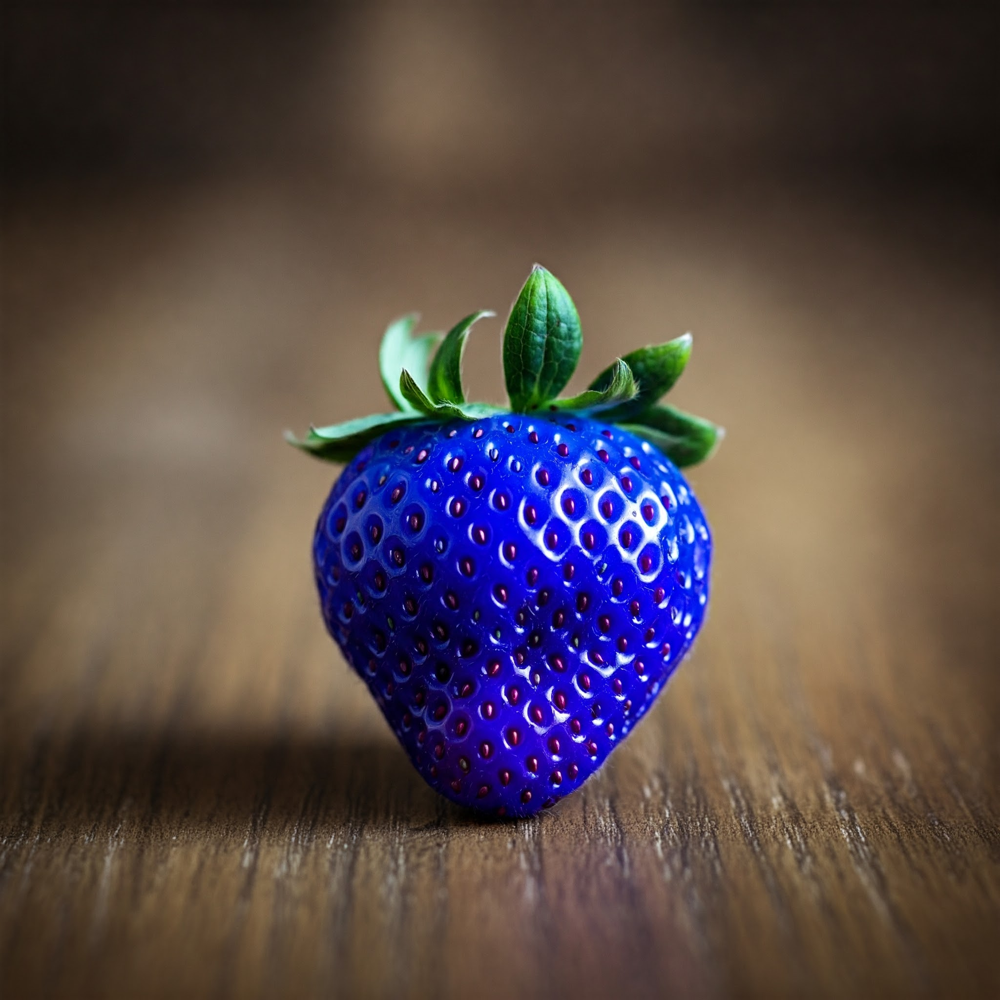

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


In [68]:
img_path = path_helper(img_files[-5])
img = Image.open(img_path)
display(img)
# schema definition
subject = "strawberry"
expected_attribute = "red"
unexpected_attribute = "blue"
row = image_five_prompts(img_path=img_path, subject=subject,
                         expected_attribute=expected_attribute,
                         unexpected_attribute=unexpected_attribute)
rows[subject] = row

## Square Basketball

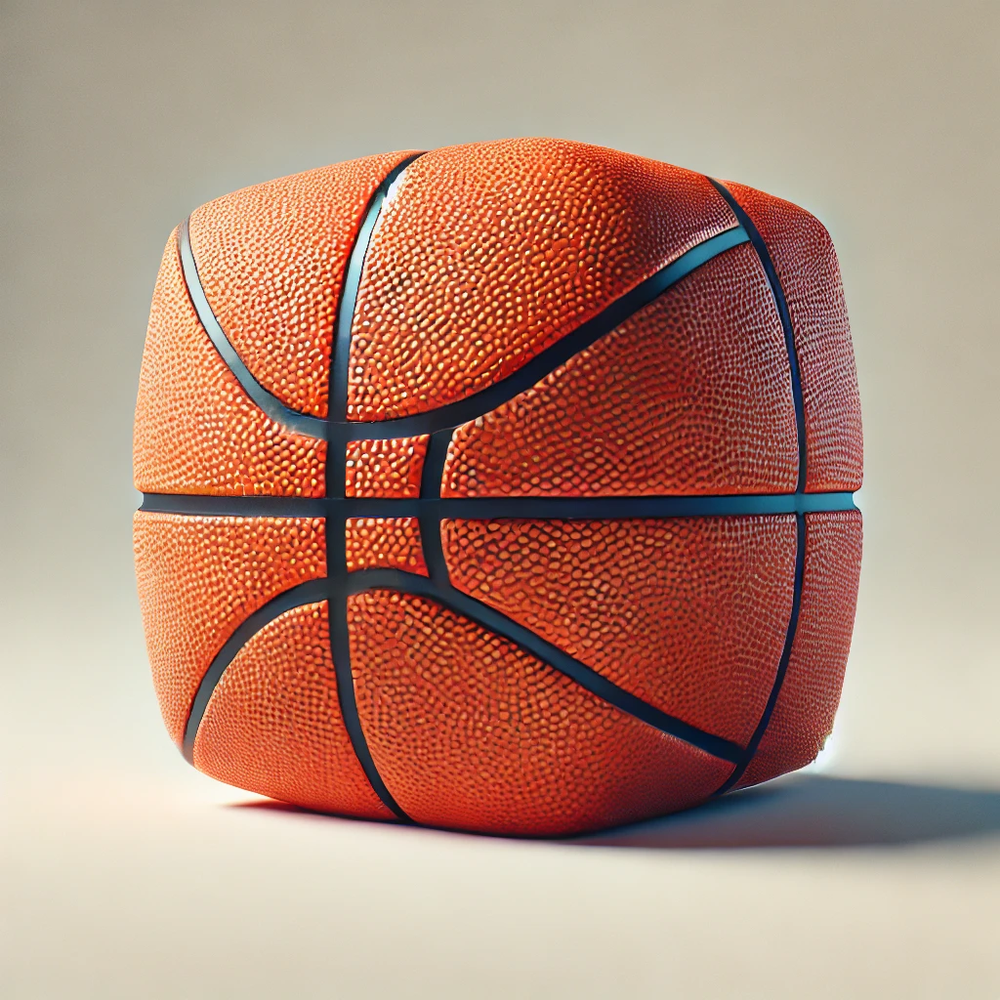

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


In [69]:
img_path = path_helper(img_files[1])
img = Image.open(img_path)
display(img)
# schema definition
subject = "basketball"
expected_attribute = "round"
unexpected_attribute = "square"
row = image_five_prompts(img_path=img_path, subject=subject,
                         expected_attribute=expected_attribute,
                         unexpected_attribute=unexpected_attribute)
rows[subject] = row

In [70]:
pd.DataFrame(rows).transpose()

,img_path,general,target_expected,target_unexpected,target_expected_2hops,target_unexpected_2hops
strawberry,/content/gdrive/MyDrive/vlm_mats_images/Gemini...,[INST] \nWhat is shown in this image? [/INST]...,[INST] \nIs the strawberry in the image red? ...,[INST] \nIs the strawberry in the image blue?...,[INST] \nIs the object in the image a strawbe...,[INST] \nIs the object in the image a strawbe...
basketball,/content/gdrive/MyDrive/vlm_mats_images/DALL·E...,[INST] \nWhat is shown in this image? [/INST]...,[INST] \nIs the basketball in the image round...,[INST] \nIs the basketball in the image squar...,[INST] \nIs the object in the image a basketb...,[INST] \nIs the object in the image a basketb...


## Round chessboard

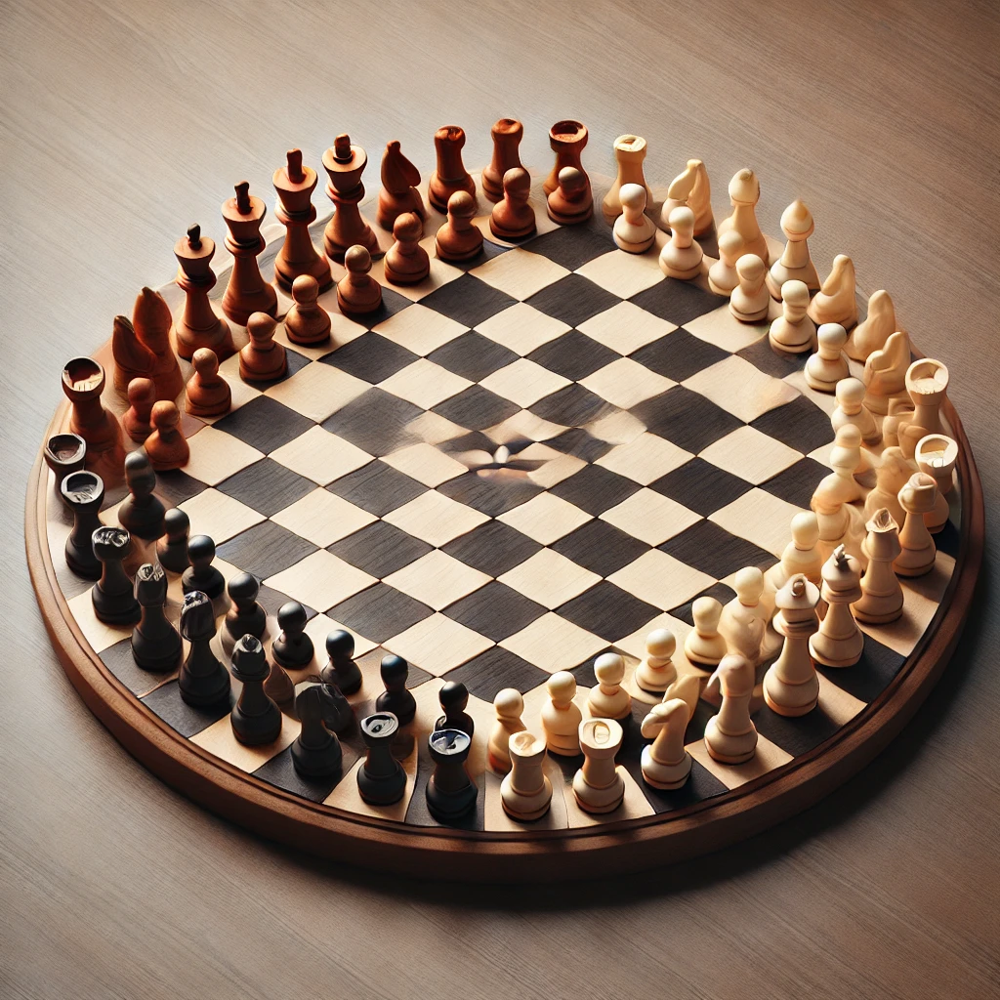

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


In [71]:
img_path = path_helper(img_files[7]) # 3 floating pyramids #5 melting chair #7 round chessboard
img = Image.open(img_path)
display(img)
subject = "chessboard"
expected_attribute = "square"
unexpected_attribute = "round"
row = image_five_prompts(img_path=img_path, subject=subject,
                         expected_attribute=expected_attribute,
                         unexpected_attribute=unexpected_attribute)
rows[subject] = row

## Floating pyramids

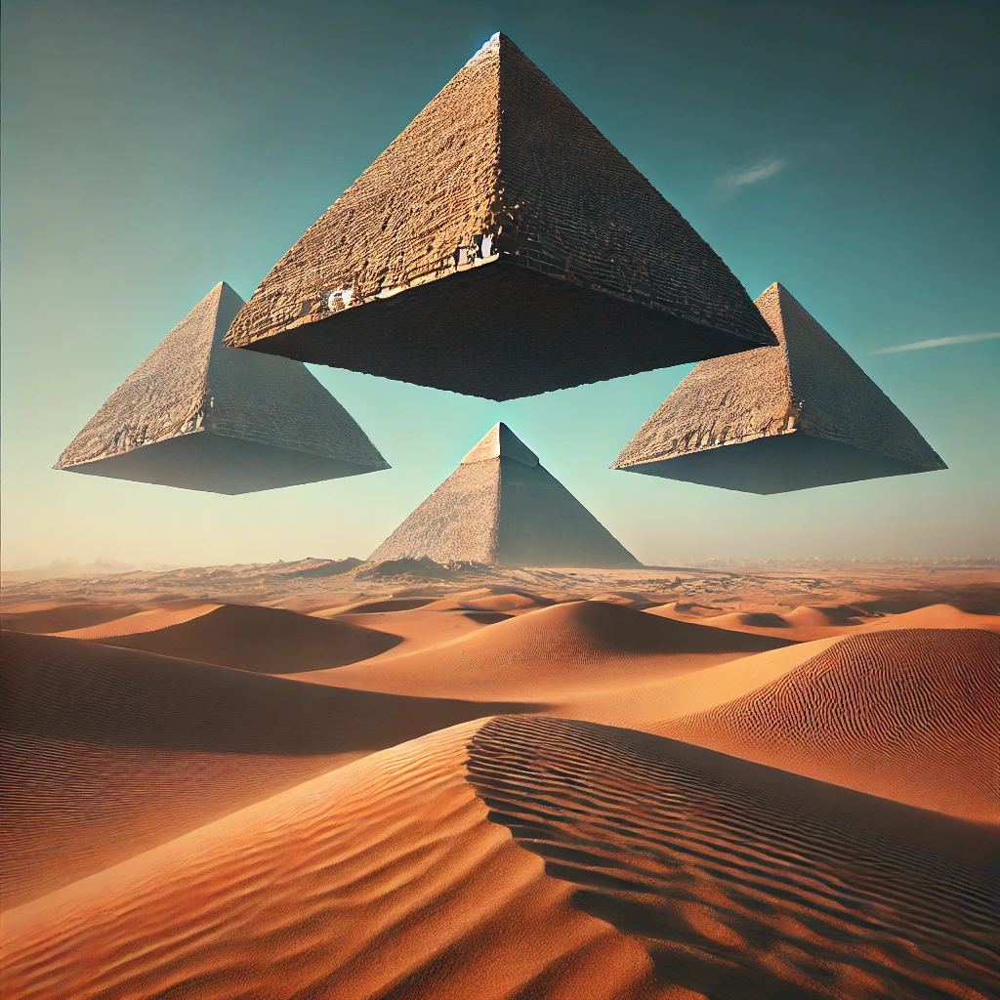

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


In [72]:
img_path = path_helper(img_files[3]) # 3 floating pyramids #5 melting chair #7 round chessboard
img = Image.open(img_path)
display(img)
subject = "pyramids"
expected_attribute = "grounded"
unexpected_attribute = "floating"
row = image_five_prompts(img_path=img_path, subject=subject,
                         expected_attribute=expected_attribute,
                         unexpected_attribute=unexpected_attribute)
rows[subject] = row

# Melting Chair

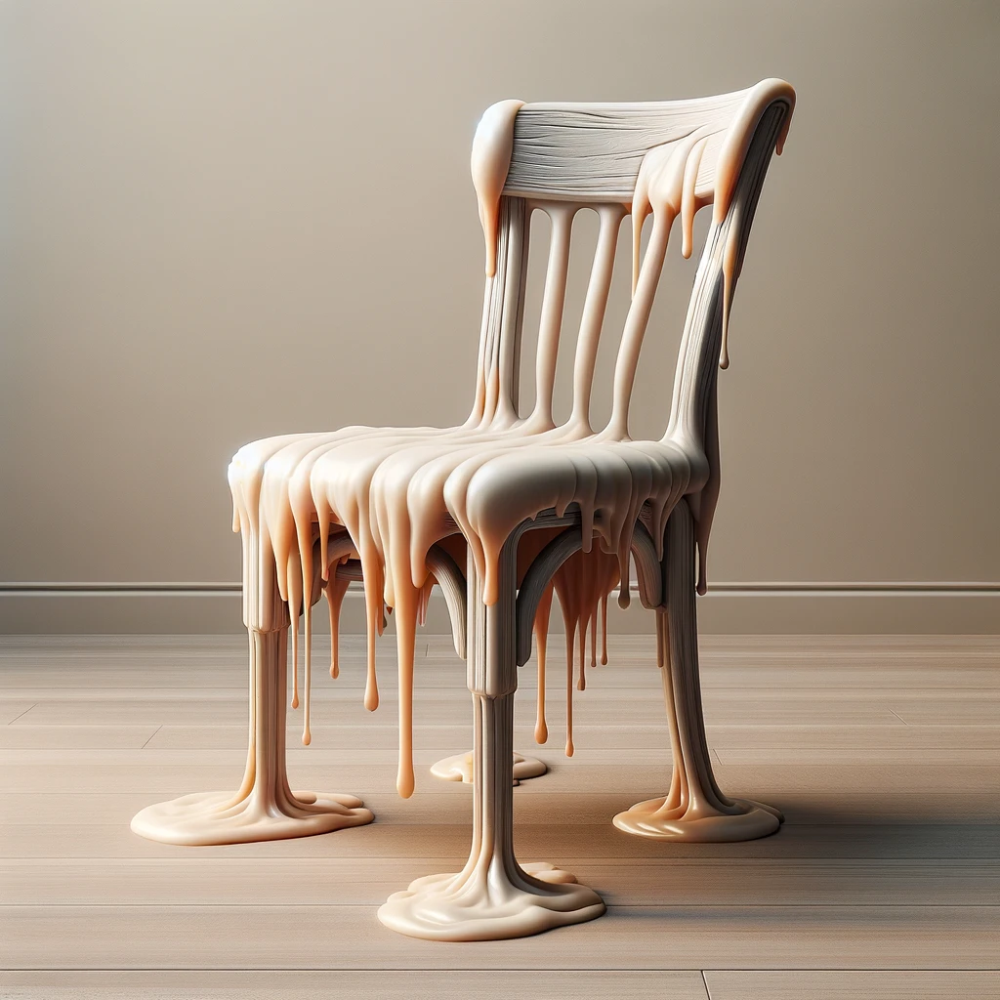

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


In [74]:
img_path = path_helper(img_files[5]) # 3 floating pyramids #5 melting chair #7 round chessboard
img = Image.open(img_path)
display(img)
subject = "chair"
expected_attribute = "dry"
unexpected_attribute = "melting"
row = image_five_prompts(img_path=img_path, subject=subject,
                         expected_attribute=expected_attribute,
                         unexpected_attribute=unexpected_attribute)
rows[subject] = row

## Cat with carrot ears

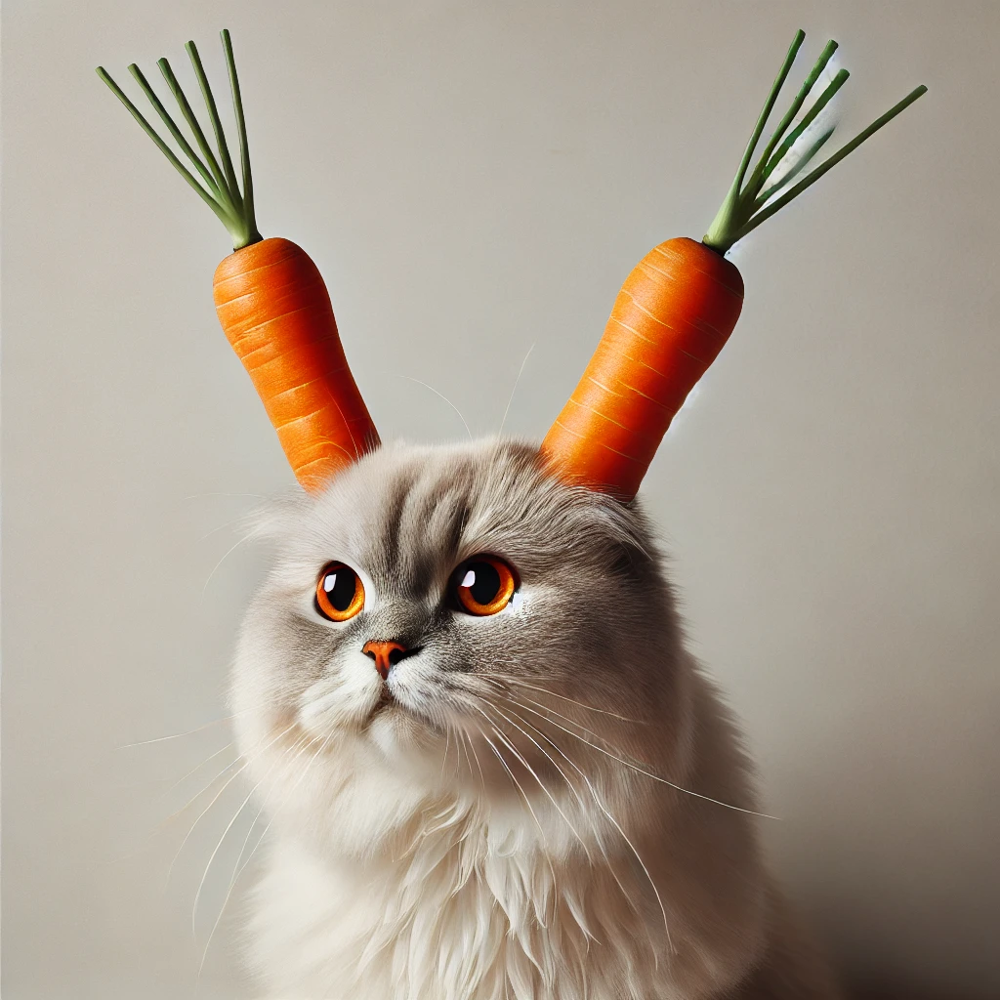

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


In [75]:
img_path = path_helper(img_files[9]) # 9 cat carrot ears #10 round rubik's cube #11 frozen sun
img = Image.open(img_path)
display(img)
subject = "cat"
expected_attribute = "normal ears"
unexpected_attribute = "carrot ears"
row = image_five_prompts_has(img_path=img_path, subject=subject,
                         expected_attribute=expected_attribute,
                         unexpected_attribute=unexpected_attribute)
rows[subject] = row

## Round Rubik's cube

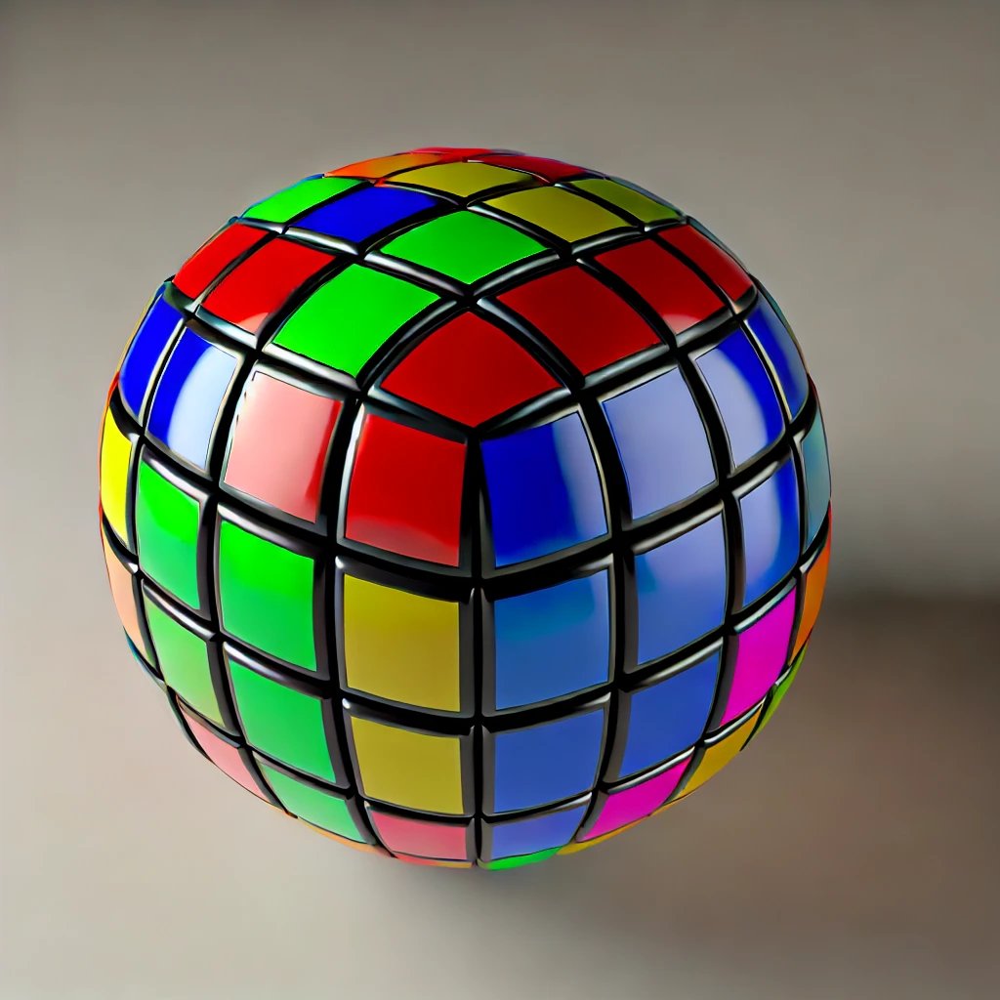

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


In [76]:
img_path = path_helper(img_files[10]) # 9 cat carrot ears #10 round rubik's cube #11 frozen sun
img = Image.open(img_path)
display(img)
subject = "rubik's cube"
expected_attribute = "square"
unexpected_attribute = "round"
row = image_five_prompts(img_path=img_path, subject=subject,
                         expected_attribute=expected_attribute,
                         unexpected_attribute=unexpected_attribute)
rows[subject] = row

## Frozen Sun

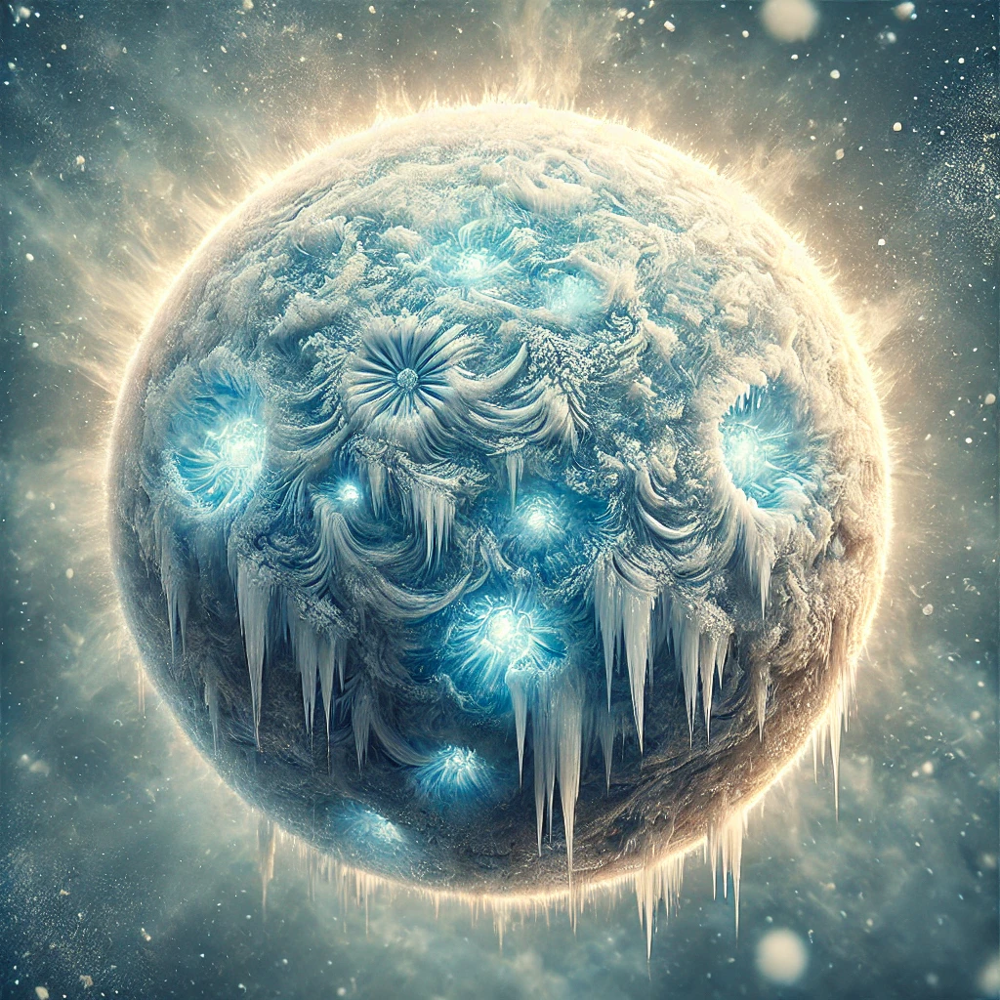

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


In [77]:
img_path = path_helper(img_files[11]) # 9 cat carrot ears #10 round rubik's cube #11 frozen sun
img = Image.open(img_path)
display(img)
subject = "sun"
expected_attribute = "hot"
unexpected_attribute = "cold"
row = image_five_prompts(img_path=img_path, subject=subject,
                         expected_attribute=expected_attribute,
                         unexpected_attribute=unexpected_attribute)
rows[subject] = row

## Dog with wings

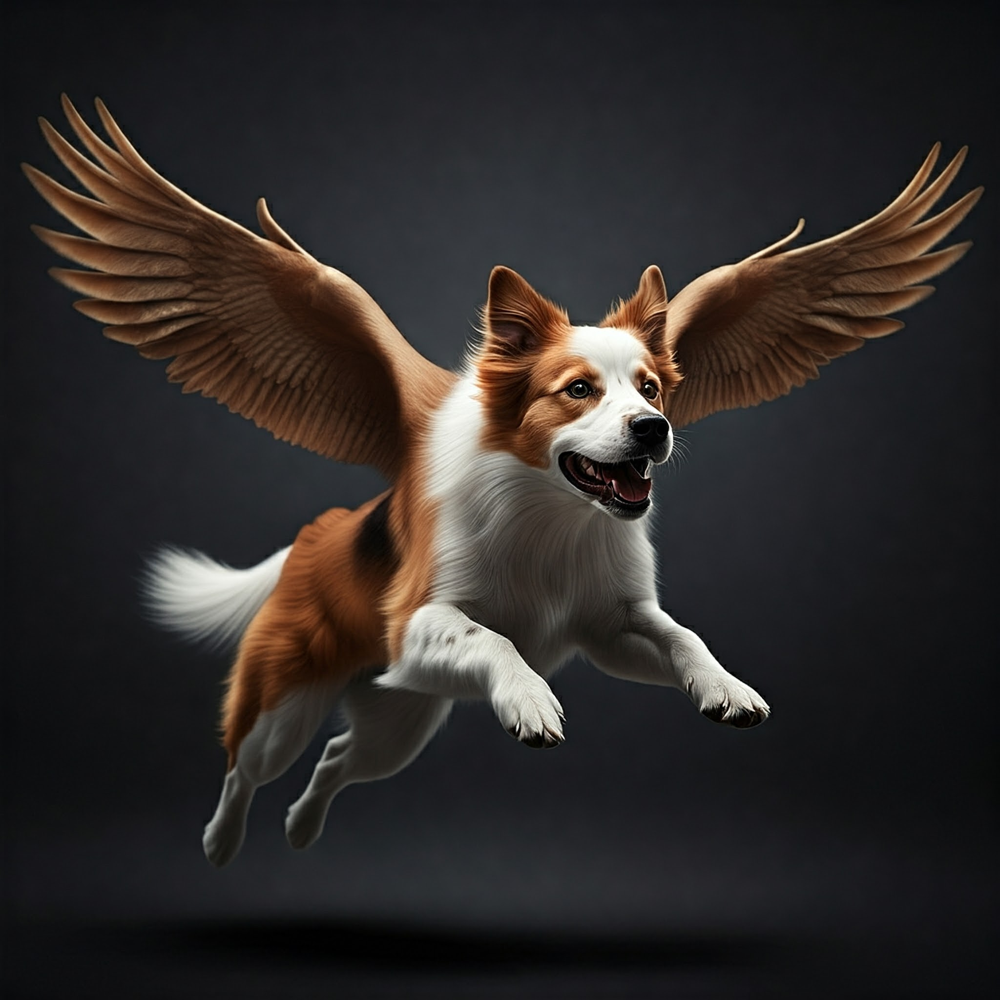

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


In [78]:
img_path = path_helper(img_files[13])
img = Image.open(img_path)
display(img)
subject = "dog"
expected_attribute = "normal back"
unexpected_attribute = "wings"
row = image_five_prompts_has(img_path=img_path, subject=subject,
                         expected_attribute=expected_attribute,
                         unexpected_attribute=unexpected_attribute)
rows[subject] = row

In [79]:
df = pd.DataFrame(rows).transpose()
df

,img_path,general,target_expected,target_unexpected,target_expected_2hops,target_unexpected_2hops
strawberry,/content/gdrive/MyDrive/vlm_mats_images/Gemini...,[INST] \nWhat is shown in this image? [/INST]...,[INST] \nIs the strawberry in the image red? ...,[INST] \nIs the strawberry in the image blue?...,[INST] \nIs the object in the image a strawbe...,[INST] \nIs the object in the image a strawbe...
basketball,/content/gdrive/MyDrive/vlm_mats_images/DALL·E...,[INST] \nWhat is shown in this image? [/INST]...,[INST] \nIs the basketball in the image round...,[INST] \nIs the basketball in the image squar...,[INST] \nIs the object in the image a basketb...,[INST] \nIs the object in the image a basketb...
chessboard,/content/gdrive/MyDrive/vlm_mats_images/DALL·E...,[INST] \nWhat is shown in this image? [/INST]...,[INST] \nIs the chessboard in the image squar...,[INST] \nIs the chessboard in the image round...,[INST] \nIs the object in the image a chessbo...,[INST] \nIs the object in the image a chessbo...
pyramids,/content/gdrive/MyDrive/vlm_mats_images/DALL·E...,[INST] \nWhat is shown in this image? [/INST]...,[INST] \nIs the pyramids in the image grounde...,[INST] \nIs the pyramids in the image floatin...,[INST] \nIs the object in the image a pyramid...,[INST] \nIs the object in the image a pyramid...
chair,/content/gdrive/MyDrive/vlm_mats_images/DALL·E...,[INST] \nWhat is shown in this image? [/INST]...,[INST] \nIs the chair in the image dry? Answe...,[INST] \nIs the chair in the image melting? A...,[INST] \nIs the object in the image a chair? ...,[INST] \nIs the object in the image a chair? ...
cat,/content/gdrive/MyDrive/vlm_mats_images/DALL·E...,[INST] \nWhat is shown in this image? [/INST]...,[INST] \nDoes the cat in the image have norma...,[INST] \nDoes the cat in the image have carro...,[INST] \nIs the object in the image a cat? If...,[INST] \nIs the object in the image a cat? If...
rubik's cube,/content/gdrive/MyDrive/vlm_mats_images/DALL·E...,[INST] \nWhat is shown in this image? [/INST]...,[INST] \nIs the rubik's cube in the image squ...,[INST] \nIs the rubik's cube in the image rou...,[INST] \nIs the object in the image a rubik's...,[INST] \nIs the object in the image a rubik's...
sun,/content/gdrive/MyDrive/vlm_mats_images/DALL·E...,[INST] \nWhat is shown in this image? [/INST]...,[INST] \nIs the sun in the image hot? Answer ...,[INST] \nIs the sun in the image cold? Answer...,[INST] \nIs the object in the image a sun? If...,[INST] \nIs the object in the image a sun? If...
dog,/content/gdrive/MyDrive/vlm_mats_images/Gemini...,[INST] \nWhat is shown in this image? [/INST]...,[INST] \nDoes the dog in the image have norma...,[INST] \nDoes the dog in the image have wings...,[INST] \nIs the object in the image a dog? If...,[INST] \nIs the object in the image a dog? If...
